# TACO Inspection Demo

This notebook contains several independent scripts that show how to load and visualize the dataset stats and annotated images:
- Section 1 shows the dataset stats
- Section 2 show the class hierarchical structure: super classes and classes
- Section 3 shows TACO images along with their segmentation masks

But first we need to load the annotations and some python libraries:

In [2]:
%matplotlib inline
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

dataset_path = r'/work3/s212725/WasteProject/data'
anns_file_path = dataset_path + '/' + 'annotations.json'

# Read annotations
with open(anns_file_path, 'r') as f:
    dataset = json.loads(f.read())

categories = dataset['categories']
anns = dataset['annotations']
imgs = dataset['images']
nr_cats = len(categories)
nr_annotations = len(anns)
nr_images = len(imgs)

# Load categories and super categories
cat_names = []
super_cat_names = []
super_cat_ids = {}
super_cat_last_name = ''
nr_super_cats = 0
for cat_it in categories:
    cat_names.append(cat_it['name'])
    super_cat_name = cat_it['supercategory']
    # Adding new supercat
    if super_cat_name != super_cat_last_name:
        super_cat_names.append(super_cat_name)
        super_cat_ids[super_cat_name] = nr_super_cats
        super_cat_last_name = super_cat_name
        nr_super_cats += 1

print('Number of super categories:', nr_super_cats)
print('Number of categories:', nr_cats)
print('Number of annotations:', nr_annotations)
print('Number of images:', nr_images)

Number of super categories: 28
Number of categories: 60
Number of annotations: 4784
Number of images: 1500


# Python script understanding

In [11]:
category_names = []
supercategory_names = []
supercateogry_ids = []
supercategory_last_name = ''
supercategory_id_to_name = {}
nr_supercategories = 0

# Create a dictionary that maps supercategory names to IDs and store all supercategory names
for category in categories:
    category_names.append(category['name'])
    supercategory_name = category['supercategory']
    if supercategory_name not in supercategory_names:
        supercategory_names.append(supercategory_name)
        supercategory_id_to_name[supercategory_name] = nr_supercategories
        nr_supercategories += 1

First we need to map images ids to categories ids

In [12]:
# images_id -> category_id
# Create a dictionary that maps image IDs to category_id
images_id_to_category_id = {}
annotations = dataset['annotations']
for annotation in annotations:
    image_id = annotation['image_id']
    category_id = annotation['category_id']
    images_id_to_category_id[image_id] = category_id

In [13]:
print(images_id_to_category_id)

{0: 6, 1: 14, 2: 7, 3: 12, 4: 12, 5: 50, 6: 11, 7: 7, 8: 5, 9: 50, 10: 39, 11: 29, 12: 8, 13: 45, 14: 4, 15: 7, 16: 33, 17: 20, 18: 12, 19: 50, 20: 50, 21: 50, 22: 50, 23: 7, 24: 11, 25: 39, 26: 39, 27: 7, 28: 5, 29: 12, 30: 59, 31: 12, 32: 12, 33: 50, 34: 40, 35: 13, 36: 5, 37: 6, 38: 42, 39: 6, 40: 6, 41: 33, 42: 12, 43: 23, 44: 50, 45: 10, 46: 50, 47: 15, 48: 15, 49: 15, 50: 59, 51: 12, 52: 12, 53: 14, 54: 59, 55: 12, 56: 59, 57: 59, 58: 34, 59: 34, 60: 59, 61: 42, 62: 27, 63: 12, 64: 59, 65: 59, 66: 59, 67: 31, 68: 25, 69: 8, 70: 39, 71: 43, 72: 25, 73: 53, 74: 38, 75: 7, 76: 50, 77: 27, 78: 22, 79: 22, 80: 23, 81: 58, 82: 54, 83: 36, 84: 7, 85: 50, 86: 59, 87: 12, 88: 45, 89: 59, 90: 33, 91: 42, 92: 25, 93: 59, 94: 8, 95: 8, 96: 12, 97: 0, 98: 31, 99: 0, 100: 14, 101: 5, 102: 58, 103: 36, 104: 58, 105: 58, 106: 58, 107: 58, 108: 58, 109: 36, 110: 58, 111: 5, 112: 31, 113: 5, 114: 6, 115: 31, 116: 58, 117: 36, 118: 58, 119: 0, 120: 33, 121: 59, 122: 59, 123: 39, 124: 5, 125: 53, 12

Our goal is to reduce the categories to super categories, in other words, mapping the supercategories to the images ids

In [14]:
# category_id -> supercategory
category_id_to_supercategory = {}
for category in categories:
    category_id = category['id']
    supercategory_name = category['supercategory']
    category_id_to_supercategory[category_id] = supercategory_name
    
print(category_id_to_supercategory)

{0: 'Aluminium foil', 1: 'Battery', 2: 'Blister pack', 3: 'Blister pack', 4: 'Bottle', 5: 'Bottle', 6: 'Bottle', 7: 'Bottle cap', 8: 'Bottle cap', 9: 'Broken glass', 10: 'Can', 11: 'Can', 12: 'Can', 13: 'Carton', 14: 'Carton', 15: 'Carton', 16: 'Carton', 17: 'Carton', 18: 'Carton', 19: 'Carton', 20: 'Cup', 21: 'Cup', 22: 'Cup', 23: 'Cup', 24: 'Cup', 25: 'Food waste', 26: 'Glass jar', 27: 'Lid', 28: 'Lid', 29: 'Other plastic', 30: 'Paper', 31: 'Paper', 32: 'Paper', 33: 'Paper', 34: 'Paper bag', 35: 'Paper bag', 36: 'Plastic bag & wrapper', 37: 'Plastic bag & wrapper', 38: 'Plastic bag & wrapper', 39: 'Plastic bag & wrapper', 40: 'Plastic bag & wrapper', 41: 'Plastic bag & wrapper', 42: 'Plastic bag & wrapper', 43: 'Plastic container', 44: 'Plastic container', 45: 'Plastic container', 46: 'Plastic container', 47: 'Plastic container', 48: 'Plastic glooves', 49: 'Plastic utensils', 50: 'Pop tab', 51: 'Rope & strings', 52: 'Scrap metal', 53: 'Shoe', 54: 'Squeezable tube', 55: 'Straw', 56: '

Having both mappings we can now map from the image id to the supercategory

In [15]:
images_id_to_supercategory = {}    
for annotation in annotations:
    image_id = annotation['image_id']
    cat_id = images_id_to_category_id[annotations[image_id]['image_id']]
    super_cat = category_id_to_supercategory[cat_id]
    images_id_to_supercategory[image_id] = super_cat

print(images_id_to_supercategory)

{0: 'Bottle', 1: 'Carton', 2: 'Carton', 3: 'Bottle cap', 4: 'Bottle cap', 5: 'Can', 6: 'Can', 7: 'Can', 8: 'Can', 9: 'Can', 10: 'Pop tab', 11: 'Pop tab', 12: 'Pop tab', 13: 'Pop tab', 14: 'Pop tab', 15: 'Pop tab', 16: 'Can', 17: 'Bottle cap', 18: 'Bottle cap', 19: 'Bottle', 20: 'Pop tab', 21: 'Pop tab', 22: 'Pop tab', 23: 'Plastic bag & wrapper', 24: 'Plastic bag & wrapper', 25: 'Other plastic', 26: 'Other plastic', 27: 'Other plastic', 28: 'Other plastic', 29: 'Other plastic', 30: 'Other plastic', 31: 'Bottle cap', 32: 'Bottle cap', 33: 'Bottle cap', 34: 'Bottle cap', 35: 'Bottle cap', 36: 'Bottle cap', 37: 'Bottle cap', 38: 'Bottle cap', 39: 'Bottle cap', 40: 'Bottle cap', 41: 'Plastic container', 42: 'Plastic container', 43: 'Plastic container', 44: 'Plastic container', 45: 'Bottle', 46: 'Bottle cap', 47: 'Bottle cap', 48: 'Bottle cap', 49: 'Paper', 50: 'Paper', 51: 'Cup', 52: 'Can', 53: 'Pop tab', 54: 'Pop tab', 55: 'Pop tab', 56: 'Pop tab', 57: 'Pop tab', 58: 'Pop tab', 59: 'Pop t

Last part of the script - get_item method

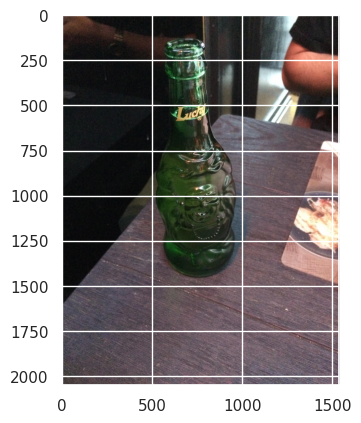

[([517.0, 127.0, 447.0, 1322.0], [[561.0, 1238.0, 568.0, 1201.0, 567.0, 1175.0, 549.0, 1127.0, 538.0, 1089.0, 519.0, 1043.0, 517.0, 1005.0, 523.0, 964.0, 529.0, 945.0, 520.0, 896.0, 525.0, 862.0, 536.0, 821.0, 554.0, 769.0, 577.0, 727.0, 595.0, 678.0, 596.0, 585.0, 588.0, 346.0, 581.0, 328.0, 569.0, 306.0, 570.0, 276.0, 576.0, 224.0, 560.0, 205.0, 564.0, 170.0, 578.0, 154.0, 608.0, 136.0, 649.0, 127.0, 688.0, 127.0, 726.0, 129.0, 759.0, 141.0, 784.0, 153.0, 792.0, 177.0, 788.0, 193.0, 782.0, 209.0, 792.0, 238.0, 802.0, 271.0, 802.0, 294.0, 791.0, 319.0, 789.0, 360.0, 794.0, 395.0, 810.0, 529.0, 819.0, 609.0, 841.0, 675.0, 882.0, 728.0, 916.0, 781.0, 928.0, 802.0, 938.0, 834.0, 940.0, 856.0, 939.0, 873.0, 938.0, 884.0, 944.0, 901.0, 951.0, 917.0, 956.0, 942.0, 960.0, 972.0, 964.0, 1013.0, 959.0, 1036.0, 952.0, 1081.0, 952.0, 1106.0, 934.0, 1163.0, 935.0, 1174.0, 949.0, 1209.0, 954.0, 1235.0, 952.0, 1273.0, 953.0, 1296.0, 946.0, 1320.0, 930.0, 1347.0, 914.0, 1367.0, 898.0, 1388.0, 855.0,

In [18]:
def get_annotations(image_id):
        """Returns all annotations (bounding boxes and labels) for a given image_id."""
        dataset_path = r'/dtu/datasets1/02514/data_wastedetection'
        anns_file_path = dataset_path + '/' + 'annotations.json'

        # Read annotations
        with open(anns_file_path, 'r') as f:
            dataset = json.loads(f.read())

        categories = dataset['categories']
        anns = dataset['annotations']
        annotations = []
        for ann in anns:
            if ann['image_id'] == image_id:
                bbox = ann['bbox']
                segmentation = ann['segmentation']
                area = ann['area']
                iscrowd = ann['iscrowd']
                annotations.append((bbox, segmentation, area, iscrowd))
        return annotations

from PIL import Image

images = imgs
image_id = images[0]["id"]
image_path = dataset_path + '/' + images[0]['file_name']
image = Image.open(image_path).convert('RGB')
# Display the image
plt.imshow(image)
plt.show()
super_cat = images_id_to_supercategory[image_id]
annotations = get_annotations(image_id)

# Convert annotations to tensors
num_objs = len(annotations)
boxes = []
areas = []
iscrowdlist = []
segmentations = []
print(annotations)

In [44]:
import torch
"""Returns all annotations (bounding boxes and labels) for a given image_id."""
dataset_path = r'/dtu/datasets1/02514/data_wastedetection'
anns_file_path = dataset_path + '/' + 'annotations.json'

# Read annotations
with open(anns_file_path, 'r') as f:
    dataset = json.loads(f.read())

categories = dataset['categories']
annotations = dataset['annotations']
image_id = images[0]["id"]
annotations = get_annotations(image_id)
boxes = []
areas = []
iscrowdlist = []
segmentations = []
# Convert annotations to tensors
num_objs = len(annotations)
print(num_objs)
for i in range(num_objs):
    boxes.append(annotations[i][0])
    segmentations = annotations[i][1][0]
    area = annotations[i][2]
    areas.append(area)
    iscrowd = annotations[i][3]
    iscrowdlist.append(iscrowd)
            
boxes = torch.as_tensor(boxes, dtype=torch.float32)
areas = torch.as_tensor(areas, dtype=torch.float32)
iscrowd = torch.as_tensor(iscrowdlist, dtype=torch.int64)
segmentations = torch.as_tensor(segmentations, dtype=torch.float32)

# Create target dictionary
target = {}
target['supercategory'] = super_cat
target['boxes'] = boxes
target['segmentations'] = segmentations
target['area'] = areas
target['iscrowd'] = iscrowd
target['image_id'] = torch.tensor([image_id])

1


In [46]:
target['area']

tensor([403954.])

In [53]:
print(target['supercategory'])
print(target['segmentations'])
print(target['image_id'])

Bottle
tensor([])
tensor([0])


In [37]:
print(image_id)
print(annotations)
print(image_path)
print(super_cat)

0
[]
/dtu/datasets1/02514/data_wastedetection/batch_1/000006.jpg
Bottle


# Script understanding finished

In [13]:
print(supercategory_id_to_name)
print(supercategory_names)

{'Aluminium foil': 0, 'Battery': 1, 'Blister pack': 2, 'Bottle': 3, 'Bottle cap': 4, 'Broken glass': 5, 'Can': 6, 'Carton': 7, 'Cup': 8, 'Food waste': 9, 'Glass jar': 10, 'Lid': 11, 'Other plastic': 12, 'Paper': 13, 'Paper bag': 14, 'Plastic bag & wrapper': 15, 'Plastic container': 16, 'Plastic glooves': 17, 'Plastic utensils': 18, 'Pop tab': 19, 'Rope & strings': 20, 'Scrap metal': 21, 'Shoe': 22, 'Squeezable tube': 23, 'Straw': 24, 'Styrofoam piece': 25, 'Unlabeled litter': 26, 'Cigarette': 27}
['Aluminium foil', 'Battery', 'Blister pack', 'Bottle', 'Bottle cap', 'Broken glass', 'Can', 'Carton', 'Cup', 'Food waste', 'Glass jar', 'Lid', 'Other plastic', 'Paper', 'Paper bag', 'Plastic bag & wrapper', 'Plastic container', 'Plastic glooves', 'Plastic utensils', 'Pop tab', 'Rope & strings', 'Scrap metal', 'Shoe', 'Squeezable tube', 'Straw', 'Styrofoam piece', 'Unlabeled litter', 'Cigarette']


In [6]:
category_id_to_name = {}
for category in categories:
            category_id_to_name[category['id']] = category['name']
        
print(category_id_to_name)

{0: 'Aluminium foil', 1: 'Battery', 2: 'Aluminium blister pack', 3: 'Carded blister pack', 4: 'Other plastic bottle', 5: 'Clear plastic bottle', 6: 'Glass bottle', 7: 'Plastic bottle cap', 8: 'Metal bottle cap', 9: 'Broken glass', 10: 'Food Can', 11: 'Aerosol', 12: 'Drink can', 13: 'Toilet tube', 14: 'Other carton', 15: 'Egg carton', 16: 'Drink carton', 17: 'Corrugated carton', 18: 'Meal carton', 19: 'Pizza box', 20: 'Paper cup', 21: 'Disposable plastic cup', 22: 'Foam cup', 23: 'Glass cup', 24: 'Other plastic cup', 25: 'Food waste', 26: 'Glass jar', 27: 'Plastic lid', 28: 'Metal lid', 29: 'Other plastic', 30: 'Magazine paper', 31: 'Tissues', 32: 'Wrapping paper', 33: 'Normal paper', 34: 'Paper bag', 35: 'Plastified paper bag', 36: 'Plastic film', 37: 'Six pack rings', 38: 'Garbage bag', 39: 'Other plastic wrapper', 40: 'Single-use carrier bag', 41: 'Polypropylene bag', 42: 'Crisp packet', 43: 'Spread tub', 44: 'Tupperware', 45: 'Disposable food container', 46: 'Foam food container', 4

In [7]:
print(super_cat_ids)

{'Aluminium foil': 0, 'Battery': 1, 'Blister pack': 2, 'Bottle': 3, 'Bottle cap': 4, 'Broken glass': 5, 'Can': 6, 'Carton': 7, 'Cup': 8, 'Food waste': 9, 'Glass jar': 10, 'Lid': 11, 'Other plastic': 12, 'Paper': 13, 'Paper bag': 14, 'Plastic bag & wrapper': 15, 'Plastic container': 16, 'Plastic glooves': 17, 'Plastic utensils': 18, 'Pop tab': 19, 'Rope & strings': 20, 'Scrap metal': 21, 'Shoe': 22, 'Squeezable tube': 23, 'Straw': 24, 'Styrofoam piece': 25, 'Unlabeled litter': 26, 'Cigarette': 27}


In [2]:
print(len(dataset))

7


### Composition of the dataset object
- Info
- Images
- Categories: divided in name and super category

In [6]:
print(dataset['info'])

{'year': 2019, 'version': None, 'description': 'TACO', 'contributor': None, 'url': None, 'date_created': '2019-12-19T16:11:15.258399+00:00'}


In [7]:
print(len(dataset["images"]))

1500


In [26]:
categories = dataset['categories']
print(len(categories))
print(categories[0])
super_cat_name2 = categories[0]['supercategory']
print(super_cat_name2)
cat_name2 = categories[0]['name']
print(cat_name2)
print(nr_annotations)


60
{'supercategory': 'Aluminium foil', 'id': 0, 'name': 'Aluminium foil'}
Aluminium foil
Aluminium foil
4784


## 1.  Dataset statistics

This shows the number of annotations per category:

In [ ]:
# Count annotations
cat_histogram = np.zeros(nr_cats,dtype=int)
for ann in anns:
    cat_histogram[ann['category_id']] += 1

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(5,15))

# Convert to DataFrame
df = pd.DataFrame({'Categories': cat_names, 'Number of annotations': cat_histogram})
df = df.sort_values('Number of annotations', 0, False)

# Plot the histogram
# sns.set_color_codes("pastel")
# sns.set(style="whitegrid")
plot_1 = sns.barplot(x="Number of annotations", y="Categories", data=df,
            label="Total", color="b")

# fig = plot_1.get_figure()
# fig.savefig("output.png")

/tmp/ipykernel_8698/622915498.py:11: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_values except for the argument 'by' will be keyword-only.
  df = df.sort_values('Number of annotations', 0, False)


In [27]:
print(dataset['annotations'][0])

{'id': 1, 'image_id': 0, 'category_id': 6, 'segmentation': [[561.0, 1238.0, 568.0, 1201.0, 567.0, 1175.0, 549.0, 1127.0, 538.0, 1089.0, 519.0, 1043.0, 517.0, 1005.0, 523.0, 964.0, 529.0, 945.0, 520.0, 896.0, 525.0, 862.0, 536.0, 821.0, 554.0, 769.0, 577.0, 727.0, 595.0, 678.0, 596.0, 585.0, 588.0, 346.0, 581.0, 328.0, 569.0, 306.0, 570.0, 276.0, 576.0, 224.0, 560.0, 205.0, 564.0, 170.0, 578.0, 154.0, 608.0, 136.0, 649.0, 127.0, 688.0, 127.0, 726.0, 129.0, 759.0, 141.0, 784.0, 153.0, 792.0, 177.0, 788.0, 193.0, 782.0, 209.0, 792.0, 238.0, 802.0, 271.0, 802.0, 294.0, 791.0, 319.0, 789.0, 360.0, 794.0, 395.0, 810.0, 529.0, 819.0, 609.0, 841.0, 675.0, 882.0, 728.0, 916.0, 781.0, 928.0, 802.0, 938.0, 834.0, 940.0, 856.0, 939.0, 873.0, 938.0, 884.0, 944.0, 901.0, 951.0, 917.0, 956.0, 942.0, 960.0, 972.0, 964.0, 1013.0, 959.0, 1036.0, 952.0, 1081.0, 952.0, 1106.0, 934.0, 1163.0, 935.0, 1174.0, 949.0, 1209.0, 954.0, 1235.0, 952.0, 1273.0, 953.0, 1296.0, 946.0, 1320.0, 930.0, 1347.0, 914.0, 136

and this shows the number of annotations per super category:

/tmp/ipykernel_8698/1572437030.py:17: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_values except for the argument 'by' will be keyword-only.
  df = df.sort_values('Number of annotations', 0, False)


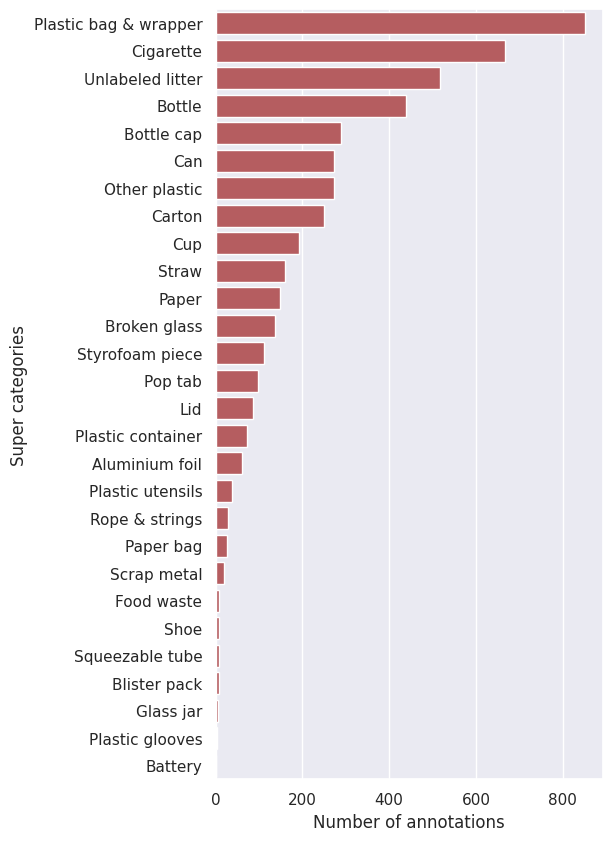

In [37]:
cat_ids_2_supercat_ids = {}
for cat in categories:
    cat_ids_2_supercat_ids[cat['id']] = super_cat_ids[cat['supercategory']]

# Count annotations
super_cat_histogram = np.zeros(nr_super_cats,dtype=int)
for ann in anns:
    cat_id = ann['category_id']
    super_cat_histogram[cat_ids_2_supercat_ids[cat_id]] +=1
    
# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(5,10))

# Convert to DataFrame
d ={'Super categories': super_cat_names, 'Number of annotations': super_cat_histogram}
df = pd.DataFrame(d)
df = df.sort_values('Number of annotations', 0, False)

# sns.set_color_codes("pastel")
# sns.set(style="whitegrid")
plot_1 = sns.barplot(x="Number of annotations", y="Super categories", data=df,
            label="Total", color="r")
plt.savefig(r'/work3/s212725/WasteProject/figures/plot_annotations_per_super_category.png')
#plot_1.set_title('Annotations per super category',fontsize=20)   

### 1.1  Background stats

In [44]:
dataset['scene_categories']

[{'id': 0, 'name': 'Clean'},
 {'id': 1, 'name': 'Indoor, Man-made'},
 {'id': 2, 'name': 'Pavement'},
 {'id': 3, 'name': 'Sand, Dirt, Pebbles'},
 {'id': 4, 'name': 'Trash'},
 {'id': 5, 'name': 'Vegetation'},
 {'id': 6, 'name': 'Water'}]

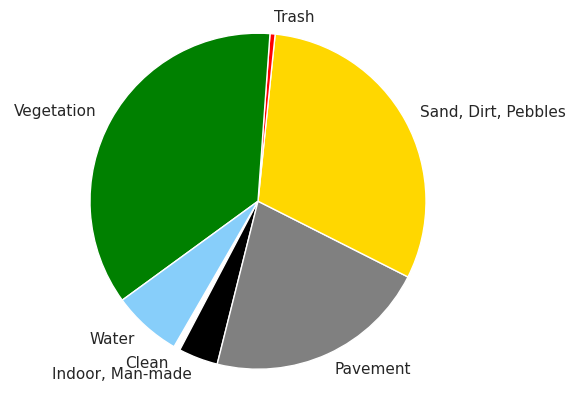

In [38]:
# Get scene cat names
scene_cats = dataset['scene_categories']
scene_name = []
for scene_cat in scene_cats:
    scene_name.append(scene_cat['name'])

nr_scenes = len(scene_cats)
scene_cat_histogram = np.zeros(nr_scenes,dtype=int)

for scene_ann in dataset['scene_annotations']:    
    scene_ann_ids = scene_ann['background_ids']
    for scene_ann_id in scene_ann_ids:
        if scene_ann_id<len(scene_cats):
            scene_cat_histogram[scene_ann_id]+=1

# Convert to DataFrame
df = pd.DataFrame({'scene_cats': scene_cats, 'nr_annotations': scene_cat_histogram})
 
# Plot
colors = ['white','black','gray', 'gold', 'red','green','lightskyblue']
plt.pie(scene_cat_histogram, labels=scene_name, colors = colors,
      shadow=False, startangle=-120)
 
plt.axis('equal')
plt.show()

## 2. Visualize dataset graph

In [46]:
pip install graphviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 1.8 MB/s eta 0:00:00

[notice] A new release of pip available: 22.2.2 -> 23.0.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


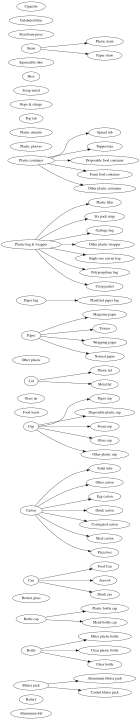

In [47]:
from graphviz import Digraph
# Note: graphviz may require more than pip installation due to path issue: e.g. brew install graphviz for mac

#g = Digraph('G', filename='hello.gv')
dot = Digraph('Dataset graph', filename='asd.gv')
dot.attr(rankdir='LR', size='8,10')

for cat_it in categories:
    dot.node(cat_it['name'])
    if cat_it['name']==cat_it['supercategory']:
        dot.node(cat_it['supercategory'])
    else:
        dot.edge(cat_it['supercategory'], cat_it['name'])
dot
# Uncomment next line to print pdf
#dot.view()

## 3. Visualize Annotated Images

For simplicity, to select and show the dataset images with the respective masks, we make use of the COCO API.
The script below shows how to load and visualize an image with all its annotations.

Unfortunately, several python libraries do not take into account the EXIF orientation tag, thus we have to explicitly rotate the images. Alternatively you can use instead OpenCV.

In [50]:
pip install pycocotools

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pycocotools: filename=pycocotools-2.0.6-cp310-cp310-linux_x86_64.whl size=405643 sha256=c34784d237e3878541dc2ed2b90337b8b0a36b9c31bb1f41ec37a722a6427ae4
  Stored in directory: /zhome/7a/d/164695/.cache/pip/wheels/58/e6/f9/f87c8f8be098b51b616871315318329cae12cdb618f4caac93
Successfully built pycocotools

[notice] A new release of pip available: 22.2.2 -> 23.0.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


loading annotations into memory...
Done (t=0.06s)
creating index...
index created!
batch_14/000022.jpg
1
(3456, 3456)


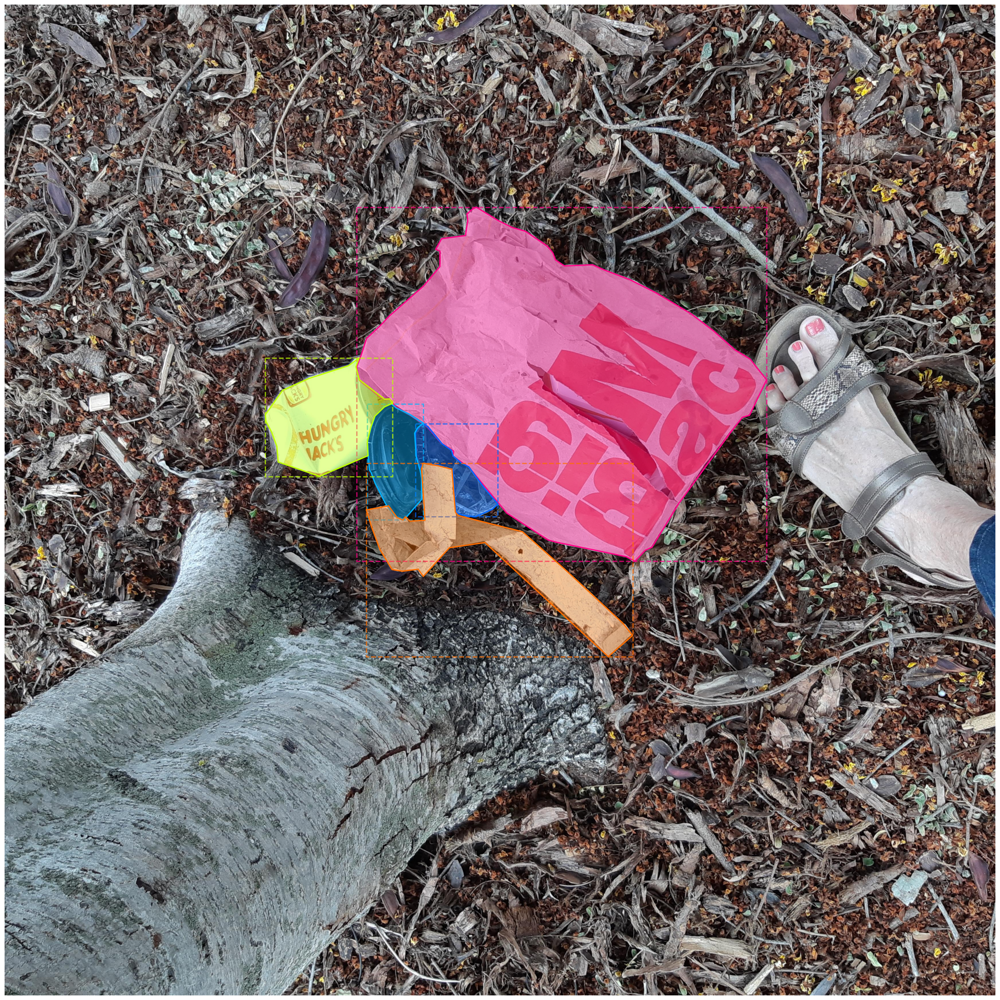

In [7]:
from PIL import Image, ExifTags
from pycocotools.coco import COCO
from matplotlib.patches import Polygon, Rectangle
from matplotlib.collections import PatchCollection
import colorsys
import random
import pylab

# User settings
image_filepath = 'batch_14/000022.jpg'
pylab.rcParams['figure.figsize'] = (28,28)
####################

# Obtain Exif orientation tag code
for orientation in ExifTags.TAGS.keys():
    if ExifTags.TAGS[orientation] == 'Orientation':
        break

# Loads dataset as a coco object
coco = COCO(anns_file_path)

# Find image id
img_id = -1
for img in imgs:
    if img['file_name'] == image_filepath:
        img_id = img['id']
        break

# Show image and corresponding annotations
if img_id == -1:
    print('Incorrect file name')
else:

    # Load image
    print(image_filepath)
    I = Image.open(dataset_path + '/' + image_filepath)

    # Load and process image metadata
    if I._getexif():
        exif = dict(I._getexif().items())
        # Rotate portrait and upside down images if necessary
        if orientation in exif:
            if exif[orientation] == 3:
                I = I.rotate(180,expand=True)
            if exif[orientation] == 6:
                I = I.rotate(270,expand=True)
            if exif[orientation] == 8:
                I = I.rotate(90,expand=True)
    print(exif[orientation])
    # Show image
    fig,ax = plt.subplots(1)
    plt.axis('off')
    print(I.size)
    plt.imshow(I)

    # Load mask ids
    annIds = coco.getAnnIds(imgIds=img_id, catIds=[], iscrowd=None)
    anns_sel = coco.loadAnns(annIds)

    # Show annotations
    for ann in anns_sel:
        color = colorsys.hsv_to_rgb(np.random.random(),1,1)
        for seg in ann['segmentation']:
            poly = Polygon(np.array(seg).reshape((int(len(seg)/2), 2)))
            p = PatchCollection([poly], facecolor=color, edgecolors=color,linewidths=0, alpha=0.4)
            ax.add_collection(p)
            p = PatchCollection([poly], facecolor='none', edgecolors=color, linewidths=2)
            ax.add_collection(p)
        [x, y, w, h] = ann['bbox']
        rect = Rectangle((x,y),w,h,linewidth=2,edgecolor=color,
                         facecolor='none', alpha=0.7, linestyle = '--')
        ax.add_patch(rect)

    plt.show()



The script below shows how to filter images by either category or supercategory.

Go ahead and try different (super)categories searches by changing the `category_name`.
Note that small objects may be hard to see.

loading annotations into memory...
Done (t=0.04s)
creating index...
index created!
Number of images found:  227


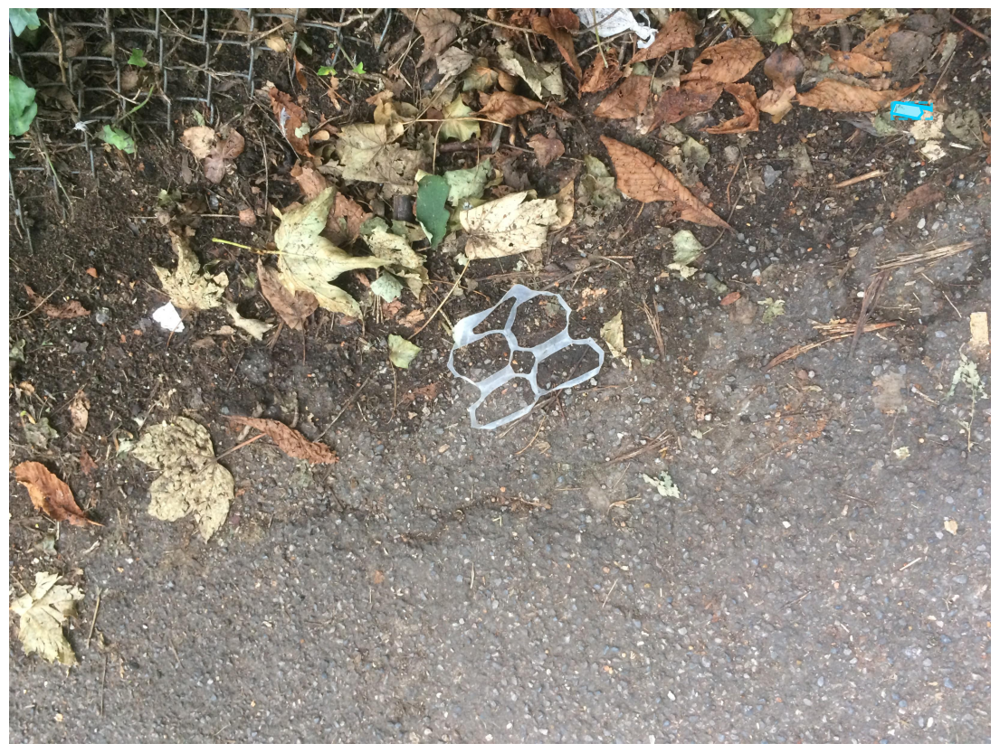

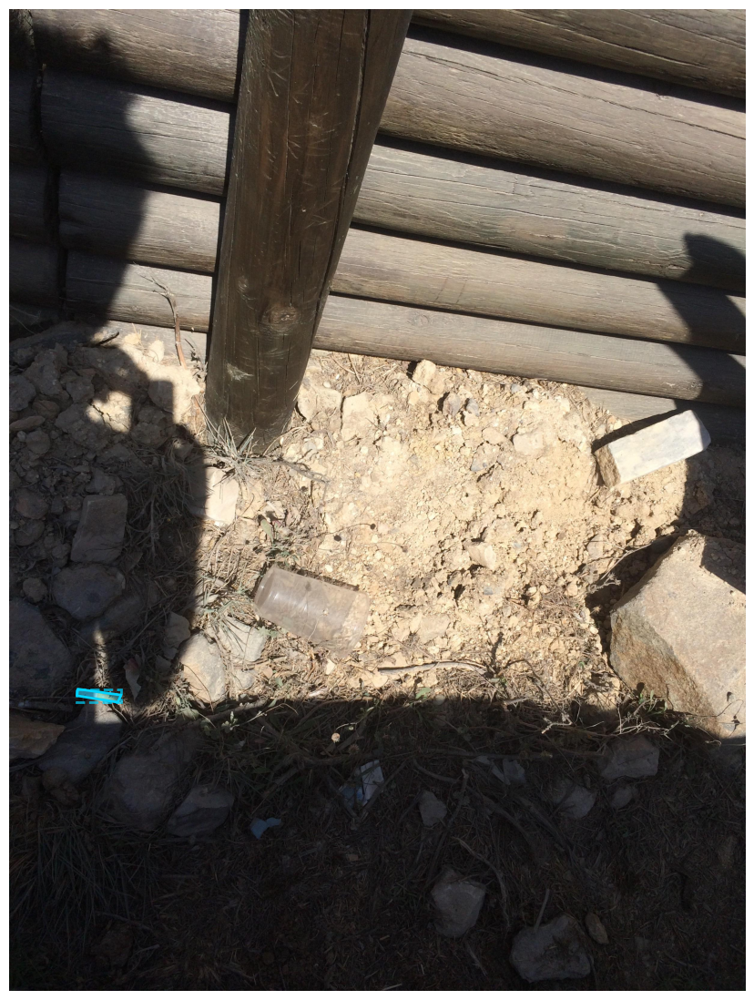

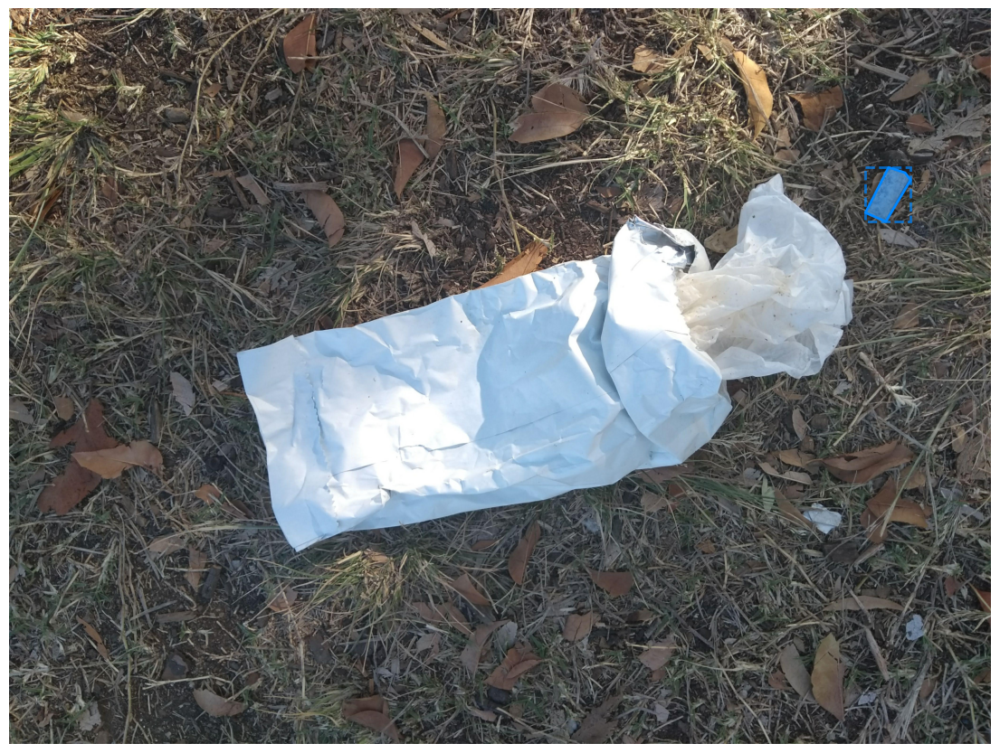

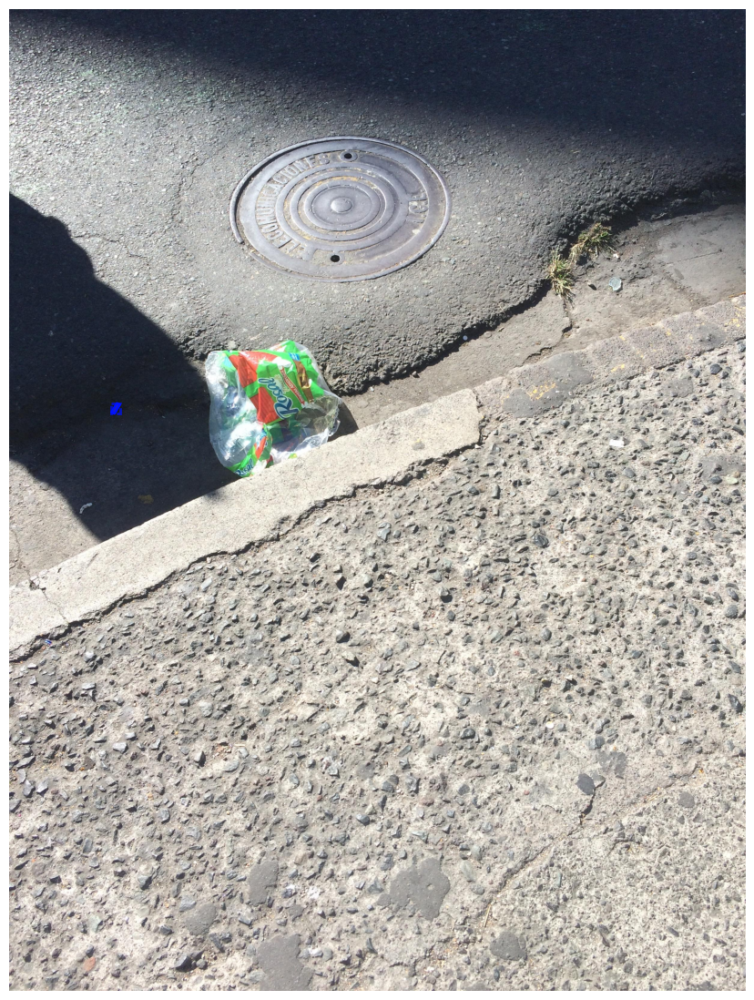

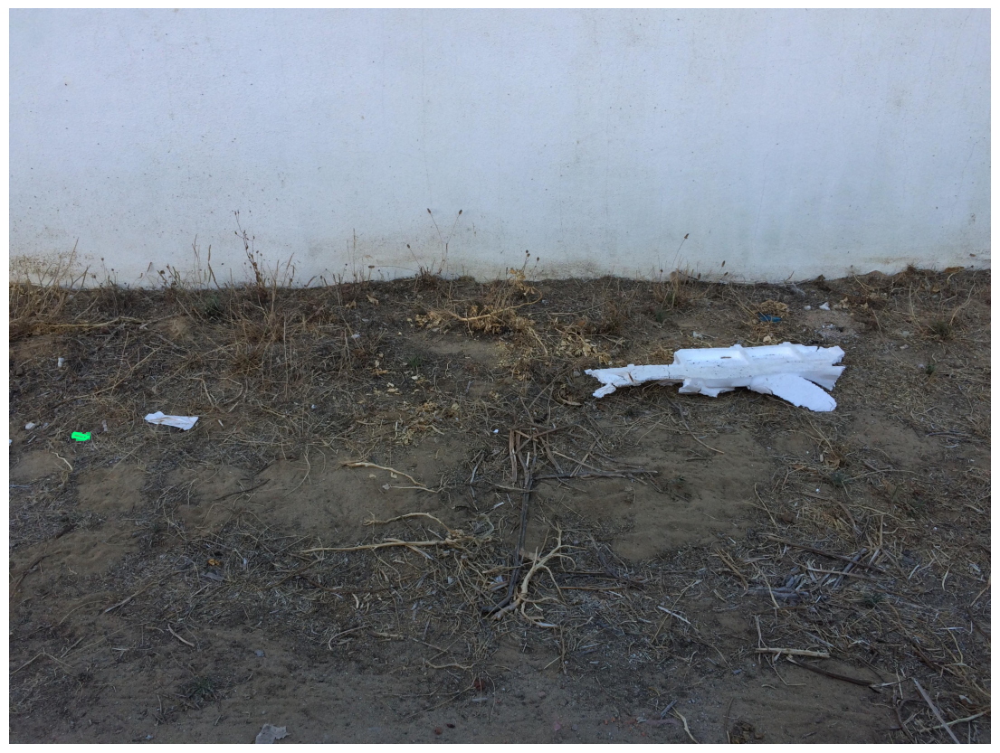

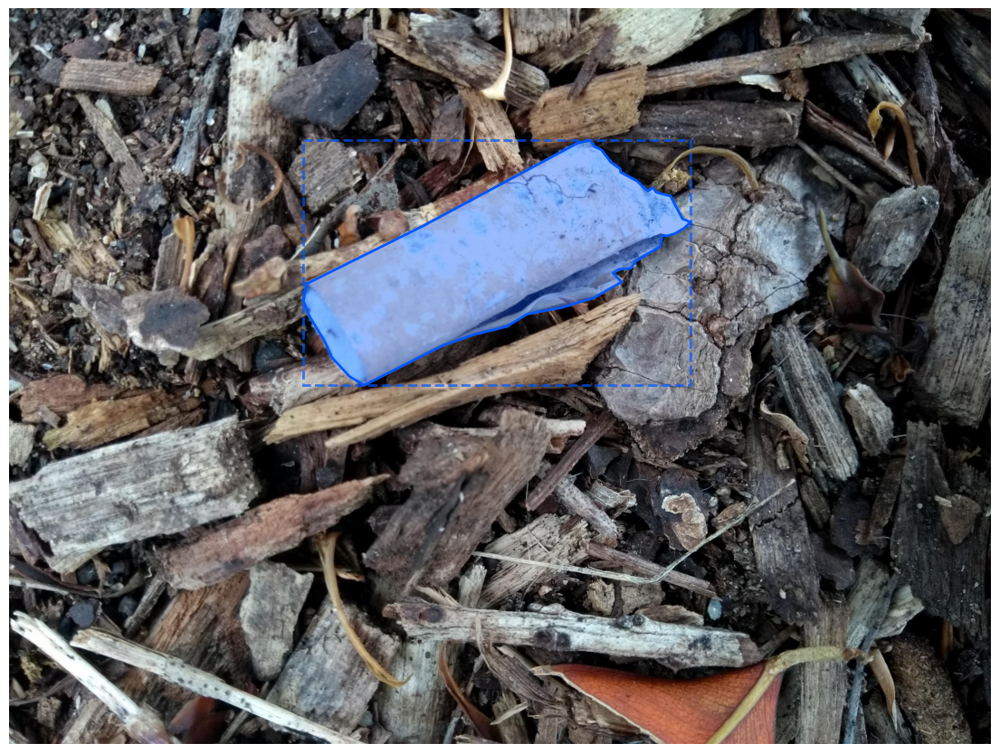

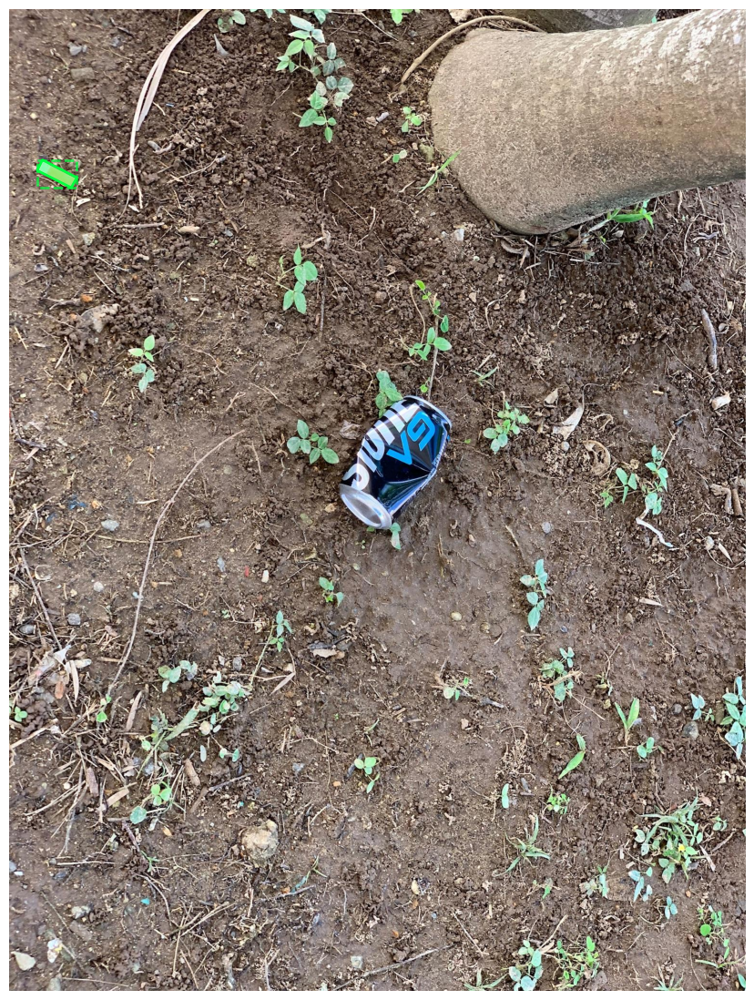

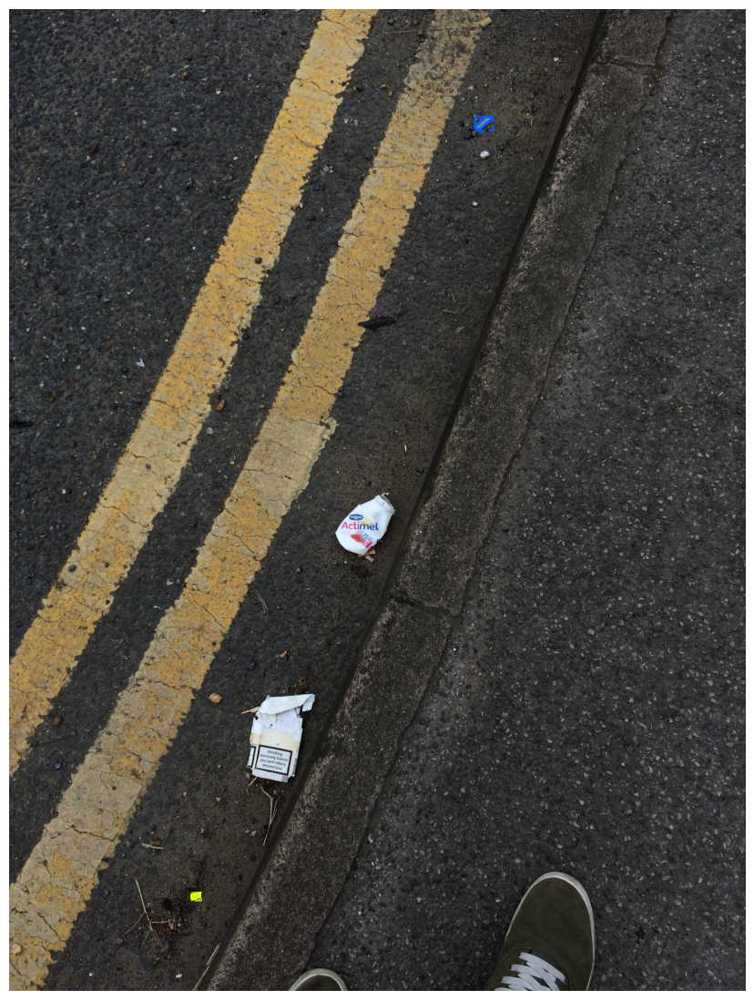

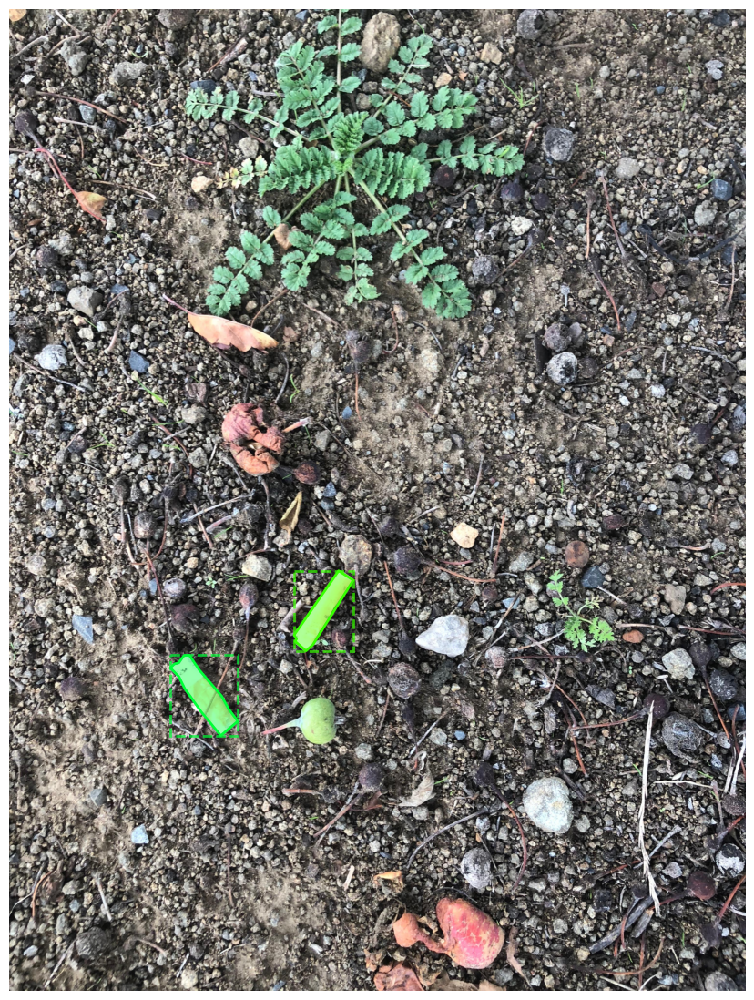

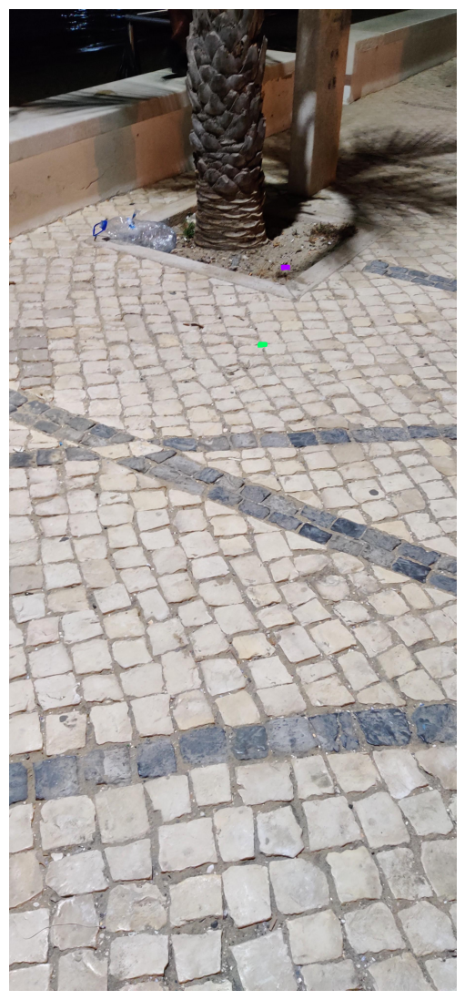

In [54]:
from PIL import Image, ExifTags
from pycocotools.coco import COCO
from matplotlib.patches import Polygon, Rectangle
from matplotlib.collections import PatchCollection
import colorsys
import random
import pylab

# User settings
nr_img_2_display = 10
category_name = 'Cigarette'#  --- Insert the name of one of the categories or super-categories above
pylab.rcParams['figure.figsize'] = (14,14)
####################

# Obtain Exif orientation tag code
for orientation in ExifTags.TAGS.keys():
    if ExifTags.TAGS[orientation] == 'Orientation':
        break

# Loads dataset as a coco object
coco = COCO(anns_file_path)

# Get image ids
imgIds = []
catIds = coco.getCatIds(catNms=[category_name])
if catIds:
    # Get all images containing an instance of the chosen category
    imgIds = coco.getImgIds(catIds=catIds)
else:
    # Get all images containing an instance of the chosen super category
    catIds = coco.getCatIds(supNms=[category_name])
    for catId in catIds:
        imgIds += (coco.getImgIds(catIds=catId))
    imgIds = list(set(imgIds))

nr_images_found = len(imgIds) 
print('Number of images found: ',nr_images_found)

# Select N random images
random.shuffle(imgIds)
imgs = coco.loadImgs(imgIds[0:min(nr_img_2_display,nr_images_found)])

for img in imgs:
    image_path = dataset_path + '/' + img['file_name']
    # Load image
    I = Image.open(image_path)
    
    # Load and process image metadata
    if I._getexif():
        exif = dict(I._getexif().items())
        # Rotate portrait and upside down images if necessary
        if orientation in exif:
            if exif[orientation] == 3:
                I = I.rotate(180,expand=True)
            if exif[orientation] == 6:
                I = I.rotate(270,expand=True)
            if exif[orientation] == 8:
                I = I.rotate(90,expand=True)
    
    # Show image
    fig,ax = plt.subplots(1)
    plt.axis('off')
    plt.imshow(I)

    # Load mask ids
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns_sel = coco.loadAnns(annIds)
    
    # Show annotations
    for ann in anns_sel:
        color = colorsys.hsv_to_rgb(np.random.random(),1,1)
        for seg in ann['segmentation']:
            poly = Polygon(np.array(seg).reshape((int(len(seg)/2), 2)))
            p = PatchCollection([poly], facecolor=color, edgecolors=color,linewidths=0, alpha=0.4)
            ax.add_collection(p)
            p = PatchCollection([poly], facecolor='none', edgecolors=color, linewidths=2)
            ax.add_collection(p)
        [x, y, w, h] = ann['bbox']
        rect = Rectangle((x,y),w,h,linewidth=2,edgecolor=color,
                         facecolor='none', alpha=0.7, linestyle = '--')
        ax.add_patch(rect)

    plt.show()
